## Распаковка тестового набора из PDBbind для структурирования данных

In [35]:
import glob
import pandas as pd
from rdkit import Chem
from rdkit.Chem import Draw, AllChem
import IPython.display as display
from io import BytesIO
import base64

/home/n_kristovsky/.conda/envs/topmol2/lib/python3.8/site-packages/psiresp/charge.py:282: FutureWarning: `symmetric_atoms_are_equivalent` will be set to False by default for now, as it is a new feature. It will be set to True by default in the future
  warnings.warn(


In [96]:
def mol2_to_chem(path_to_mol2, sanitize=True, removeHs=False):
    rdkit_chem = Chem.MolFromMol2File(path_to_mol2, sanitize=sanitize, removeHs=removeHs)
    if rdkit_chem:
        AllChem.Compute2DCoords(rdkit_chem)
    return rdkit_chem

In [97]:
def image_to_base64(img):
    buffered = BytesIO()
    img.save(buffered, format="PNG")
    return base64.b64encode(buffered.getvalue()).decode()



In [108]:
# Список путей к mol2-файлам
test_path_list = glob.glob('PDBbind_demo/*/*.mol2')

# Создание списка для хранения данных
mol_data = []
for path in test_path_list:
    mol = mol2_to_chem(path)
    if mol is None:
        continue  # Пропускаем, если не удалось загрузить молекулу
    
    # Имя соединения
    molecule_name = os.path.basename(path).split('_')[0]
    
    # Генерация 2D-изображения
    img = Draw.MolToImage(mol, size=(400, 200))
    img_base64 = image_to_base64(img)
    img_html = f'<img src="data:image/png;base64,{img_base64}" width="400" height="200">'
    
    # Подсчет заряда молекулы и количества атомов
    total_charge = sum(atom.GetFormalCharge() for atom in mol.GetAtoms())
    num_atoms = mol.GetNumAtoms()
    
    # Проверка наличия заряженных атомов
    has_charge_atoms = any(atom.GetFormalCharge() != 0 for atom in mol.GetAtoms())
    
    # Получение уникальных типов атомов
    atom_types = sorted(set(atom.GetSymbol() for atom in mol.GetAtoms()))
    atom_types_str = ",".join(atom_types)
    
    # Добавление данных в список
    mol_data.append([molecule_name, img_html, has_charge_atoms, total_charge, num_atoms, atom_types_str])

# Создание Pandas DataFrame
columns = ["Molecule_Name", "2D_Image", "Has_Charged_Atoms",  "Total_Charge", "Num_Atoms", "Atom_Types"]
df_PDBbind = pd.DataFrame(mol_data, columns=columns)

# Отключение индекса в отображении таблицы
# df.index = [''] * len(df)


[12:44:07] Warning - O.co2 with degree >1.
[12:44:08] Can't kekulize mol.  Unkekulized atoms: 1 3 7 12 14 15 16 18 20
[12:44:08] sanitise [12:44:08] 4dli_ligand: [12:44:10] Warning - O.co2 with degree >1.


,Molecule_Name,2D_Image,Has_Charged_Atoms,Total_Charge,Num_Atoms,Atom_Types
0,2y5h,,True,2,60,"C,Cl,H,N,O,S"
1,3gr2,,False,0,24,"C,H,N,O"
2,4abg,,True,2,36,"C,H,N"
3,4f2w,,True,1,40,"C,H,N,O,S"
4,4j28,,True,1,33,"C,H,N,O"
5,2cet,,True,1,43,"C,H,N,O"
6,3utu,,True,1,82,"C,Cl,H,N,O,S"
7,4ivb,,False,0,42,"C,H,N,O"
8,1z9g,,True,-1,31,"C,H,N,O,S"
9,5c28,,False,0,22,"C,Cl,H,N"

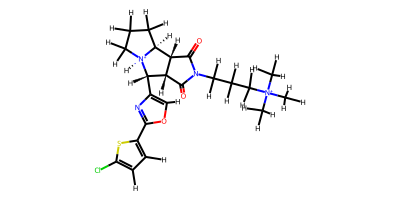
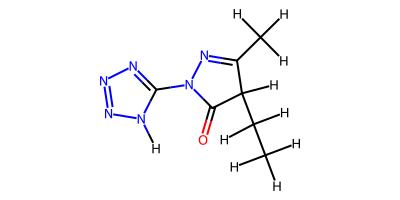
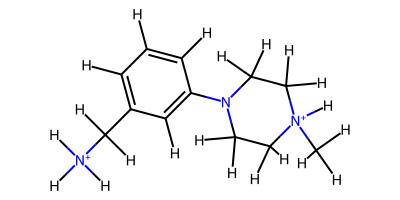
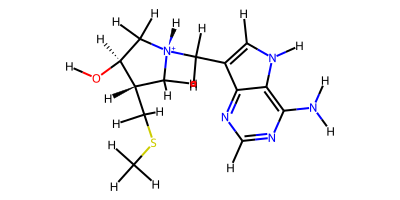
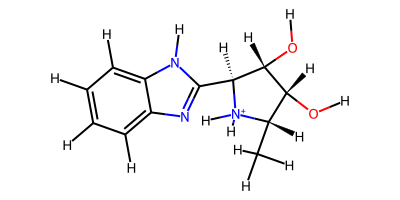
...
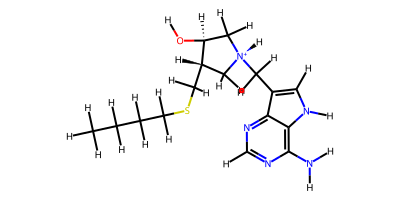
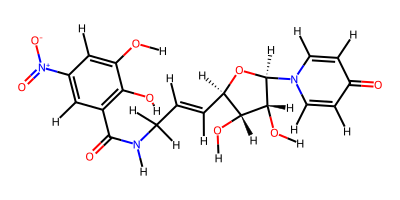
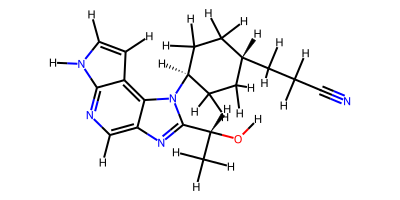
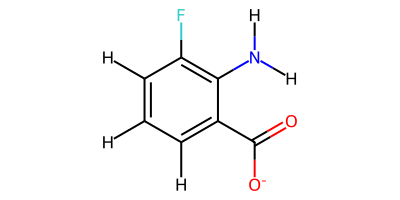
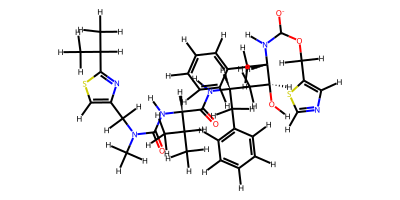

In [109]:
# Отображение изображений в DataFrame
df_PDBbind.style.set_properties(subset=['2D_Image'], **{'text-align': 'center'}, )

In [110]:
# df_PDBbind.to_csv('PDBbind_285.csv', index=False)

In [105]:
filtered_df = df[df["Has_Charged_Atoms"] == True]
filtered_df

,Molecule_Name,2D_Image,Has_Charged_Atoms,Total_Charge,Num_Atoms,Atom_Types
0,2y5h,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,2,60,"C,Cl,H,N,O,S"
2,4abg,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,2,36,"C,H,N"
3,4f2w,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,1,40,"C,H,N,O,S"
4,4j28,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,1,33,"C,H,N,O"
5,2cet,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,1,43,"C,H,N,O"
...,...,...,...,...,...,...
275,3oe4,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,0,51,"C,H,N,O"
277,4f3c,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,1,49,"C,H,N,O,S"
278,3ozt,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,0,50,"C,H,N,O"
280,4owm,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,-1,16,"C,F,H,N,O"


In [106]:
allowed_atoms = {"C", "N", "H", "O", "P"}
filtered_df = filtered_df[filtered_df["Atom_Types"].apply(lambda x: set(x.split(",")) <= allowed_atoms)]
filtered_df

,Molecule_Name,2D_Image,Has_Charged_Atoms,Total_Charge,Num_Atoms,Atom_Types
2,4abg,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,2,36,"C,H,N"
4,4j28,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,1,33,"C,H,N,O"
5,2cet,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,1,43,"C,H,N,O"
10,1syi,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,0,30,"C,H,N,O"
11,1owh,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,2,44,"C,H,N,O"
...,...,...,...,...,...,...
264,2vw5,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,-1,78,"C,H,N,O"
273,3n76,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,-1,39,"C,H,O"
274,3uex,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,-1,55,"C,H,O"
275,3oe4,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",True,0,51,"C,H,N,O"


,Molecule_Name,2D_Image,Has_Charged_Atoms,Total_Charge,Num_Atoms,Atom_Types
2,4abg,,True,2,36,"C,H,N"
4,4j28,,True,1,33,"C,H,N,O"
5,2cet,,True,1,43,"C,H,N,O"
10,1syi,,True,0,30,"C,H,N,O"
11,1owh,,True,2,44,"C,H,N,O"
12,4pcs,,True,1,32,"C,H,N,O"
14,3ag9,,True,3,140,"C,H,N,O"
21,3f3a,,True,0,27,"C,H,N,O"
22,2xys,,True,1,48,"C,H,N,O"
24,4e6q,,True,1,47,"C,H,N"

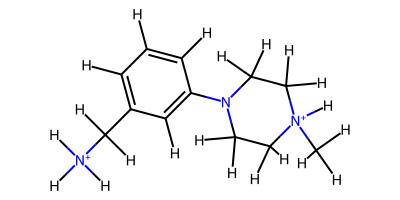
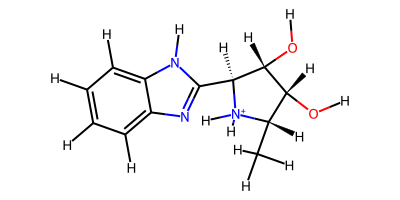
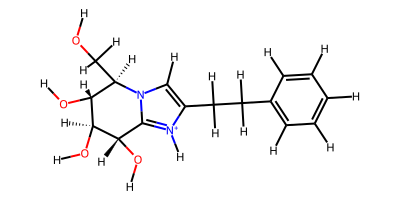
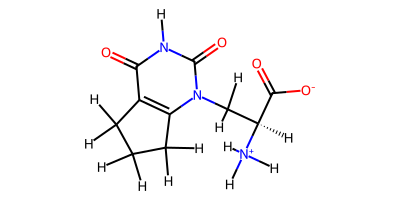
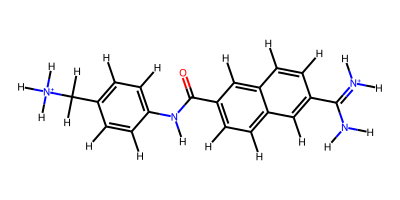
...
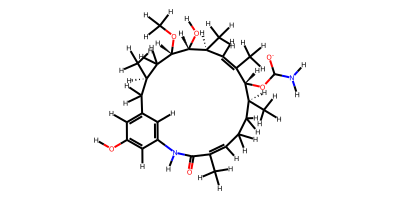
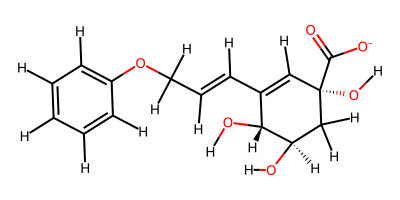
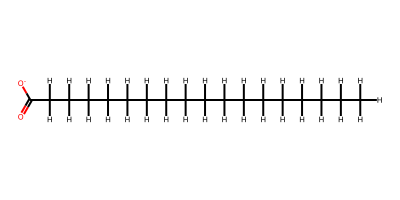
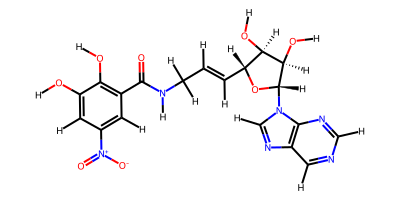
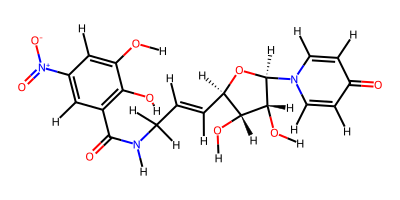

In [107]:
filtered_df.style.set_properties(subset=['2D_Image'], **{'text-align': 'center'}, )

## Распаковка тестового набора из ChEBI (amino acids)

In [125]:
import xml.etree.ElementTree as ET
import pandas as pd
from rdkit import Chem
from rdkit.Chem import Draw, Descriptors
from io import BytesIO
import base64

/home/n_kristovsky/.conda/envs/topmol2/lib/python3.8/site-packages/psiresp/charge.py:282: FutureWarning: `symmetric_atoms_are_equivalent` will be set to False by default for now, as it is a new feature. It will be set to True by default in the future
  warnings.warn(


In [126]:
def parse_chebi_xml(xml_path):
    tree = ET.parse(xml_path)
    root = tree.getroot()
    
    entries = []
    
    for entry in root.findall('ENTRY'):
        id_ = entry.find('ID').text if entry.find('ID') is not None else 'Unknown'
        name = entry.find('IUPAC_NAME').text if entry.find('IUPAC_NAME') is not None else None
        smiles = entry.find('SMILES').text if entry.find('SMILES') is not None else None
        entries.append((id_ ,name, smiles))
    
    return entries

In [127]:
def smi_to_chem(str_smi: str, sanitize=True, addH=True, make_N_root=False):
    """
    Преобразует SMILES-строку в объект молекулы RDKit и добавляет атомы водорода.
    """
    rdkit_mol = Chem.MolFromSmiles(str_smi, sanitize) # переводим во внутренний формат chem
    if addH:
        rdkit_mol = Chem.AddHs(rdkit_mol) # протонируем
        
    # Перенумерация атомов, деля аминогруппу началом молекулы
    if make_N_root:
        # Находим индекс азота из аминогруппы
        root_idx = find_amino_nitrogen(rdkit_mol)
        if root_idx != -1:
            # Получаем SMILES с корневым атомом
            smiles_string = Chem.MolToSmiles(rdkit_mol, canonical=True, allHsExplicit=True, rootedAtAtom=root_idx)
            # Создаем новую молекулу из SMILES
            rdkit_mol = Chem.MolFromSmiles(smiles_string, sanitize=False)
            if rdkit_mol is None:
                raise ValueError("Ошибка при создании молекулы после перенумерации атомов")
        else:
            print("Азот аминогруппы не найден. Корень не изменён.")
        # Chem.SanitizeMol(rdkit_mol, sanitizeOps=Chem.SANITIZE_ALL ^ Chem.SANITIZE_KEKULIZE, catchErrors=True)
        Chem.SanitizeMol(rdkit_mol)
        
        # Сортируем атомы, чтобы тяжелые атомы шли первыми, а водороды позже
        atom_order = [atom.GetIdx() for atom in rdkit_mol.GetAtoms() if atom.GetSymbol() != 'H']  # тяжелые атомы
        atom_order += [atom.GetIdx() for atom in rdkit_mol.GetAtoms() if atom.GetSymbol() == 'H']  # водороды
    
        # Перенумерация атомов согласно новому порядку
        new_rdkit_mol = Chem.RenumberAtoms(rdkit_mol, atom_order)
        # Пересчитываем валентности
        return new_rdkit_mol
    else:
        return rdkit_mol

In [128]:
xml_file = "ChEBI_Results_amino_1100.xml"
entries = parse_chebi_xml(xml_file)

In [129]:
entries

[('CHEBI:26167', None, 'OC(C(*)N)=O'),
 ('CHEBI:33704', 'alpha-amino acid', 'NC([*])C(O)=O'),
 ('CHEBI:35621', '2-aminobutanoic acid', 'CCC(N)C(O)=O'),
 ('CHEBI:15705', 'L-alpha-amino acids', 'N[C@@H]([*])C(O)=O'),
 ('CHEBI:42638',
  '2-{[3-(trifluoromethyl)phenyl]amino}benzoic acid',
  'OC(=O)c1ccccc1Nc1cccc(c1)C(F)(F)F'),
 ('CHEBI:16865', '4-aminobutanoic acid', 'NCCCC(O)=O'),
 ('CHEBI:24786', "2,2'-iminodiacetic acid", 'OC(=O)CNCC(O)=O'),
 ('CHEBI:22660', 'aspartic acid', 'NC(CC(O)=O)C(O)=O'),
 ('CHEBI:37024', '2-aminohexanedioic acid', 'NC(CCCC(O)=O)C(O)=O'),
 ('CHEBI:16080', '4-amino-3-hydroxybutanoic acid', 'NCC(O)CC(O)=O'),
 ('CHEBI:27565', '4-amino-2-hydroxybenzoic acid', 'Nc1ccc(C(O)=O)c(O)c1'),
 ('CHEBI:16586', '6-aminohexanoic acid', 'NCCCCCC(O)=O'),
 ('CHEBI:18237', 'glutamic acid', 'NC(CCC(O)=O)C(O)=O'),
 ('CHEBI:27389', '3-amino-2-methylpropanoic acid', 'CC(CN)C(O)=O'),
 ('CHEBI:21260', '2-amino-3-sulfopropanoic acid', 'NC(CS(O)(=O)=O)C(O)=O'),
 ('CHEBI:18053', '1-aminocy

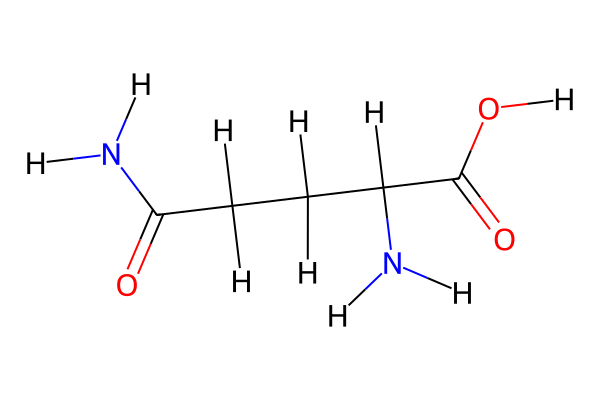

In [130]:
test_smi = entries[221][2]
smi_to_chem(test_smi)

In [131]:
mol_data = []

for id_s, name, smiles in entries:
    if id_s and smiles  :
        mol = Chem.MolFromSmiles(smiles)
        AllChem.Compute2DCoords(mol)

        img = Draw.MolToImage(mol, size=(400, 200))
        img_base64 = image_to_base64(img)
        img_html = f'<img src="data:image/png;base64,{img_base64}" width="400" height="200">'
    
        total_charge = sum(atom.GetFormalCharge() for atom in mol.GetAtoms())

        num_atoms = mol.GetNumAtoms()

        has_charged_atoms = any(atom.GetFormalCharge() != 0 for atom in mol.GetAtoms())

        atom_types = sorted(set(atom.GetSymbol() for atom in mol.GetAtoms()))
        atom_types_str = ",".join(atom_types)

        mol_data.append([id_s, img_html, smiles, has_charged_atoms, total_charge, num_atoms, atom_types_str])

columns = ["Molecule_Name", "2D_Image", "smiles", "Has_Charged_Atoms", "Total_Charge", "Num_Atoms", "Atom_Types"]
df_ChEBI = pd.DataFrame(mol_data, columns=columns)

,Molecule_Name,2D_Image,Has_Charged_Atoms,Total_Charge,Num_Atoms,Atom_Types
0,CHEBI:26167,,False,0,6,"*,C,N,O"
1,CHEBI:33704,,False,0,6,"*,C,N,O"
2,CHEBI:35621,,False,0,7,"C,N,O"
3,CHEBI:15705,,False,0,6,"*,C,N,O"
4,CHEBI:42638,,False,0,20,"C,F,N,O"
5,CHEBI:16865,,False,0,7,"C,N,O"
6,CHEBI:24786,,False,0,9,"C,N,O"
7,CHEBI:22660,,False,0,9,"C,N,O"
8,CHEBI:37024,,False,0,11,"C,N,O"
9,CHEBI:16080,,False,0,8,"C,N,O"

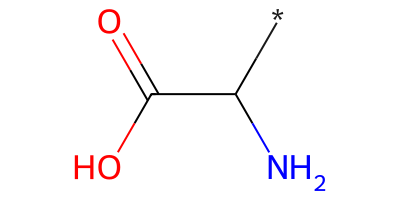
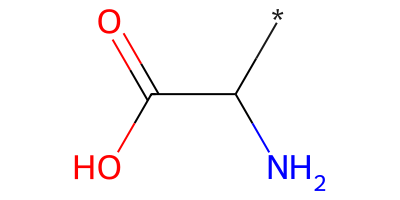
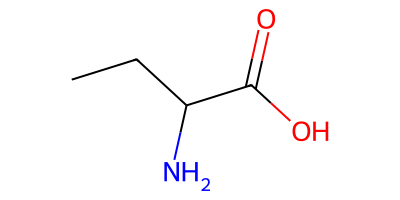
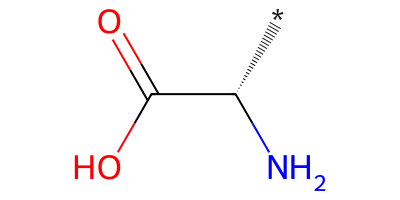
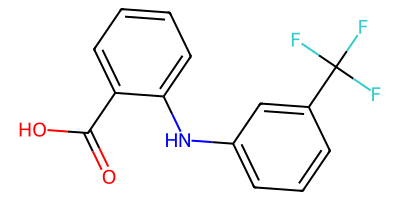
...
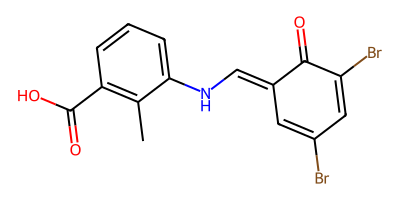
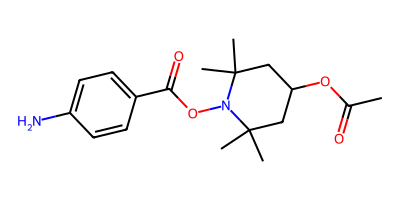
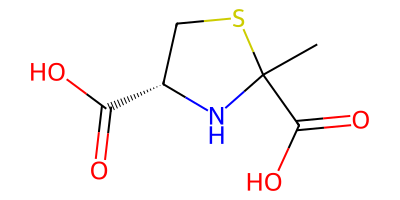
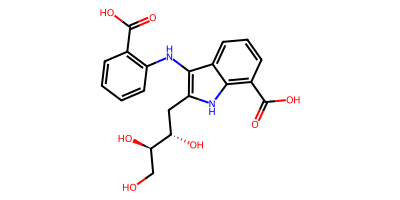
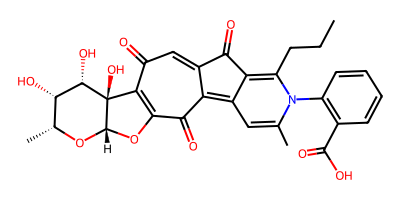

In [132]:
df_ChEBI.style.set_properties(subset=['2D_Image'], **{'text-align': 'center'}, )

In [133]:
# df_ChEBI.to_csv('ChEBI_amino_1100.csv', index=False)

In [93]:
df_ChEBI

,Molecule_Name,2D_Image,Has_Charged_Atoms,Total_Charge,Num_Atoms,Atom_Types
0,CHEBI:26167,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",False,0,6,"*,C,N,O"
1,CHEBI:33704,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",False,0,6,"*,C,N,O"
2,CHEBI:35621,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",False,0,7,"C,N,O"
3,CHEBI:15705,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",False,0,6,"*,C,N,O"
4,CHEBI:42638,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",False,0,20,"C,F,N,O"
...,...,...,...,...,...,...
1127,CHEBI:93960,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",False,0,21,"Br,C,N,O"
1128,CHEBI:151072,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",False,0,24,"C,N,O"
1129,CHEBI:195394,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",False,0,12,"C,N,O,S"
1130,CHEBI:217207,"<img src=""data:image/png;base64,iVBORw0KGgoAAA...",False,0,29,"C,N,O"


,Molecule_Name,2D_Image,Has_Charged_Atoms,Total_Charge,Num_Atoms,Atom_Types
54,CHEBI:52162,,True,0,21,"C,N,O"
253,CHEBI:61280,,True,0,13,"C,N,O"
305,CHEBI:139579,,True,0,34,"C,Cl,N,O,S"
342,CHEBI:138889,,True,0,12,"C,N,O"
354,CHEBI:65461,,True,0,11,"C,N,O"
511,CHEBI:75335,,True,0,13,"C,N,O"
558,CHEBI:228217,,True,0,15,"C,N,O"
594,CHEBI:28275,,True,0,19,"C,N,O"
662,CHEBI:72495,,True,0,25,"C,N,O"
666,CHEBI:86268,,True,0,16,"C,N,O"

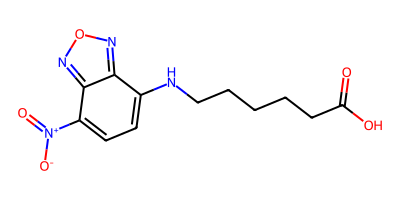
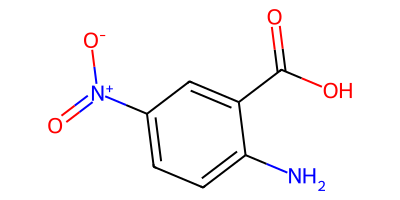
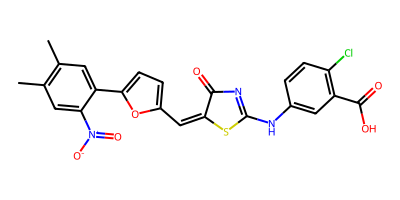
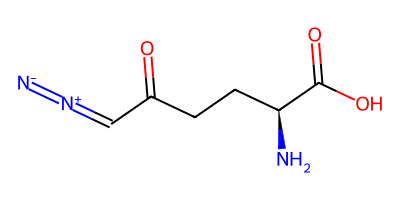
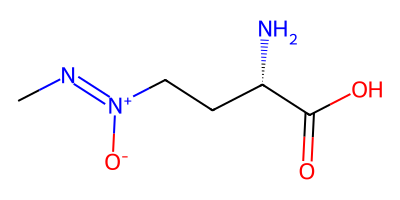
...
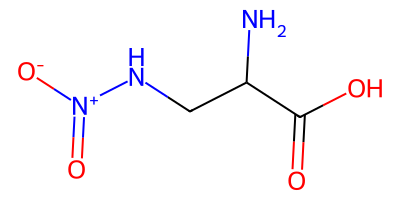
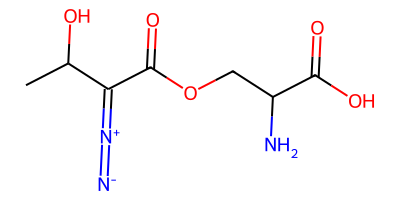
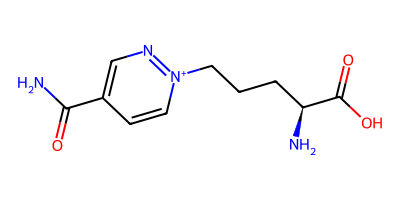
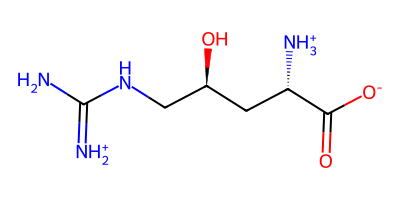
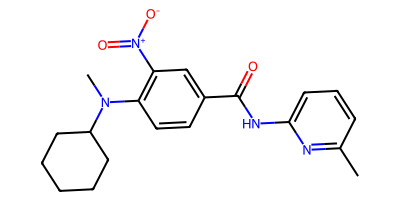

In [134]:
filtered_df = df[df["Has_Charged_Atoms"] == True]
filtered_df.style.set_properties(subset=['2D_Image'], **{'text-align': 'center'}, )